<a href="https://colab.research.google.com/github/eridona03/CVexercises/blob/main/CompVisEridonaVarosiEx1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup and Imports

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import data, filters, util, morphology, color
from skimage.transform import resize
from skimage.util import random_noise
from skimage.filters import gaussian
from skimage.morphology import disk, erosion
from skimage.io import imread
from scipy import ndimage as ndi
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
from scipy import fftpack

#Task 1: Load the built-in image 'coffee'

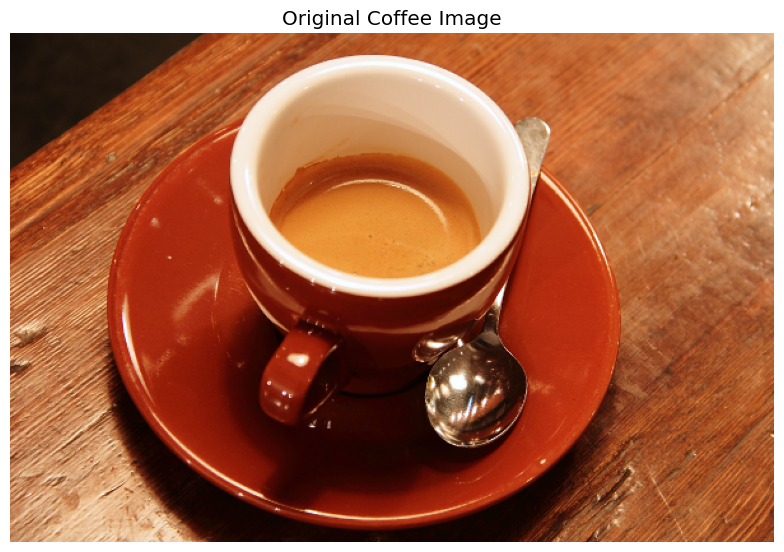

In [43]:
# Load the coffee image
coffee = data.coffee()

# Display the image
plt.figure(figsize=(8, 6))
plt.imshow(coffee)
plt.title('Original Coffee Image')
plt.axis('off')
plt.tight_layout()
plt.show()

#Task 2: Add Different Types of Noise and Compare

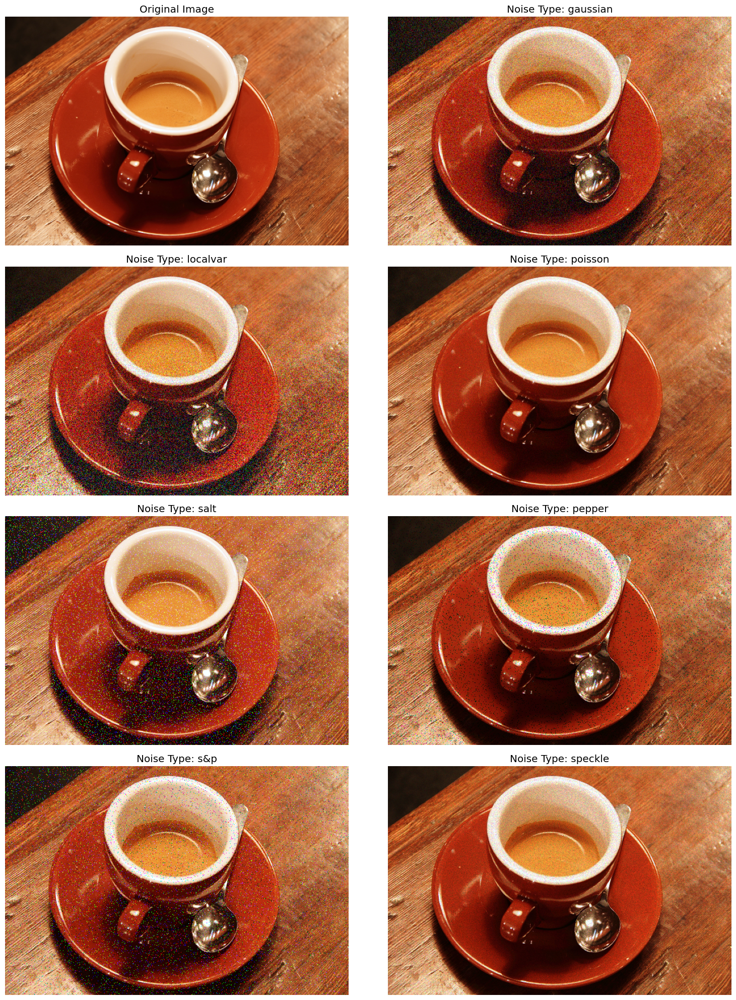

In [33]:
def add_noise_and_plot():

    noise_types = ['gaussian', 'localvar', 'poisson', 'salt', 'pepper', 's&p', 'speckle']
    fig, axes = plt.subplots(4, 2, figsize=(16, 20))

    # Plot original image in the first subplot
    axes[0, 0].imshow(coffee)
    axes[0, 0].set_title('Original Image')
    axes[0, 0].axis('off')

    # Generate images with different noise types
    for i, noise_type in enumerate(noise_types):

        row = (i + 1) // 2
        col = (i + 1) % 2

        # For localvar noise type, we need to prepare variance map
        if noise_type == 'localvar':
            # Create a synthetic variance map with same number of dimensions as the image
            height = coffee.shape[0]

            # First create a 2D variance map
            local_variance = np.ones(coffee.shape[:2]) * 0.001  # Small baseline variance

            for y in range(height):
                # Add increasing variance from top to bottom (0.001 to 0.1)
                local_variance[y, :] = 0.001 + (y / height) ** 2 * 0.099

            # If the image is RGB, replicate the variance map for each channel
            if len(coffee.shape) == 3:
                # Replicate the 2D variance map for each color channel
                local_variance = np.stack([local_variance] * coffee.shape[2], axis=-1)

            # Add localvar noise with custom variance map
            noisy = random_noise(coffee, mode=noise_type, local_vars=local_variance)
        else:
            # Add noise of specified type
            noisy = random_noise(coffee, mode=noise_type)

        # Plot the noisy image
        axes[row, col].imshow(noisy)
        axes[row, col].set_title(f'Noise Type: {noise_type}')
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

add_noise_and_plot()

## Task 3: Exploring Different Noise Intensity Levels

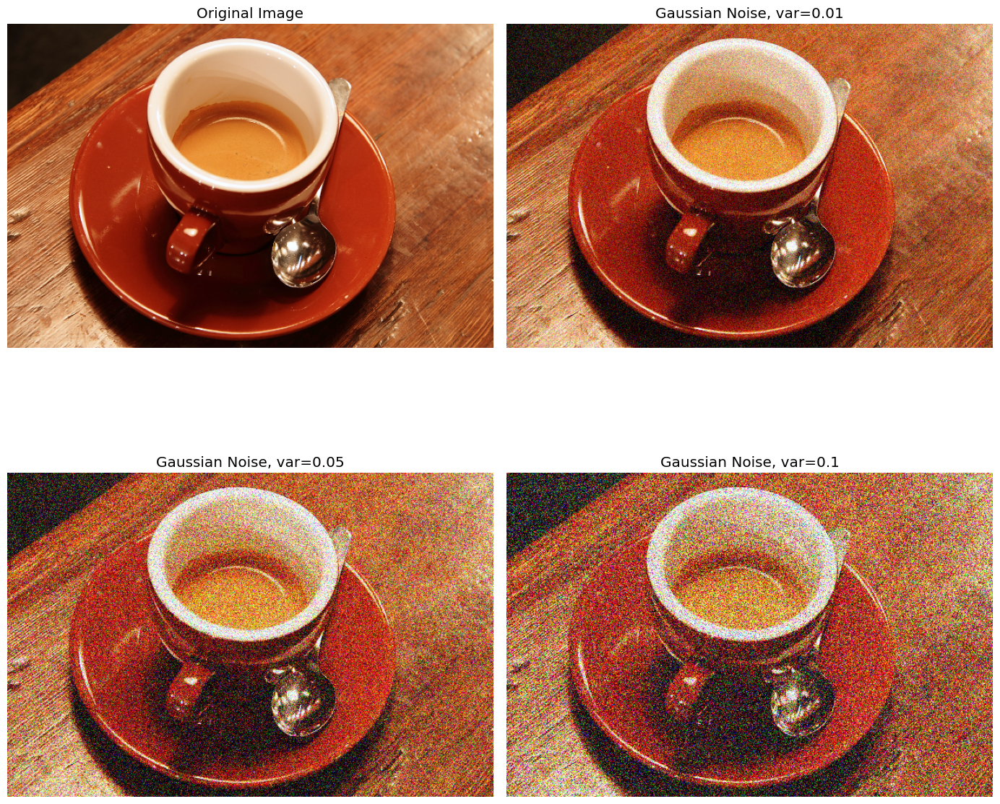

In [34]:
def explore_noise_intensity():

    noise_type = 'gaussian'  # Selecting Gaussian noise for this task

    var_levels = [0.01, 0.05, 0.1]  # Low, medium, high noise

    # Set up a 2x2 figure
    fig, axes = plt.subplots(2, 2, figsize=(14, 14))

    # Original image in the top-left corner
    axes[0, 0].imshow(coffee)
    axes[0, 0].set_title('Original Image')
    axes[0, 0].axis('off')

    # Generate and plot images with different noise intensity levels
    for i, var in enumerate(var_levels):

        row = (i + 1) // 2
        col = (i + 1) % 2

        # Add gaussian noise with specified variance
        noisy = random_noise(coffee, mode=noise_type, var=var)

        # Plot noisy image
        axes[row, col].imshow(noisy)
        axes[row, col].set_title(f'Gaussian Noise, var={var}')
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

    # Return the image with highest noise level for next task
    return random_noise(coffee, mode=noise_type, var=var_levels[-1])

# Generate noisy images and get the highest noise image for next task
high_noise_img = explore_noise_intensity()

## Task 4: Exploring the Effect of Sigma in Gaussian Filtering

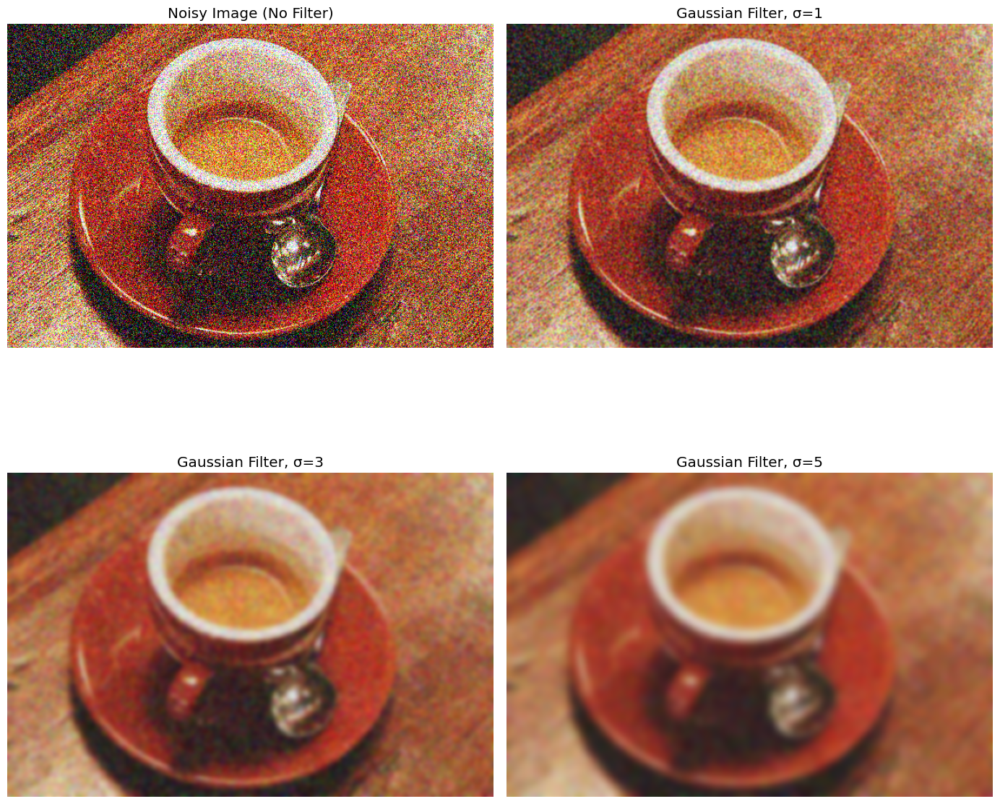

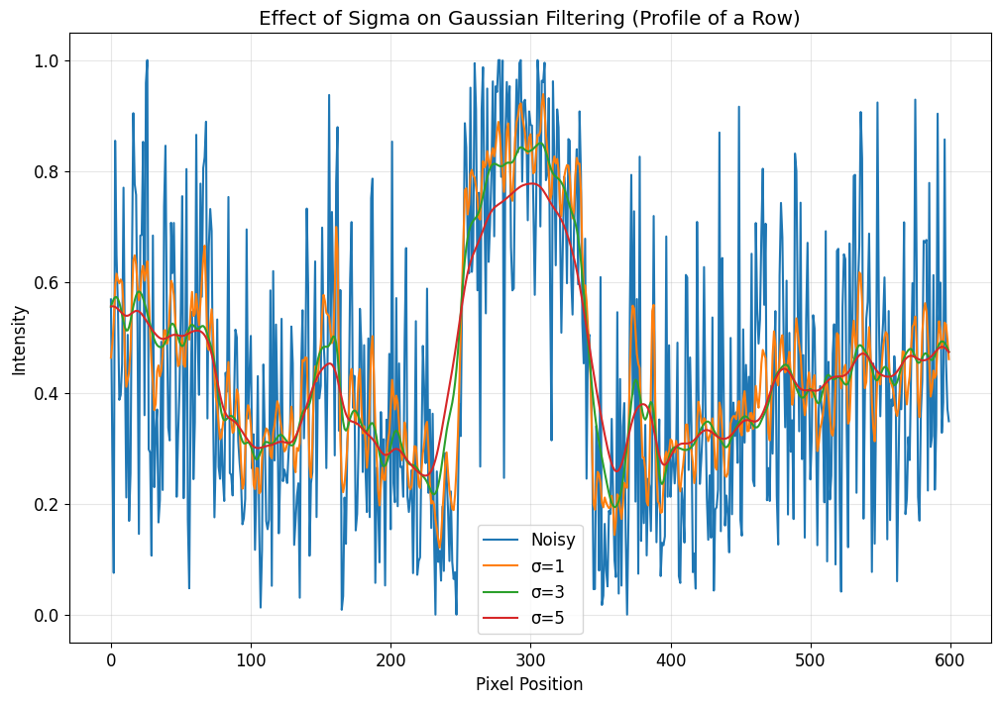

In [44]:
def explore_gaussian_filter(noisy_image):

    sigma_values = [1, 3, 5]
    fig, axes = plt.subplots(2, 2, figsize=(14, 14))

    # Original noisy image in top-left
    axes[0, 0].imshow(noisy_image)
    axes[0, 0].set_title('Noisy Image (No Filter)')
    axes[0, 0].axis('off')

    for i, sigma in enumerate(sigma_values):
        # Calculate position in the grid
        row = (i + 1) // 2
        col = (i + 1) % 2

        # Apply gaussian filter
        filtered = gaussian(noisy_image, sigma=sigma, channel_axis=-1)

        # Plot filtered image
        axes[row, col].imshow(filtered)
        axes[row, col].set_title(f'Gaussian Filter, σ={sigma}')
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

    # Now plot the profiles of a row to see the differences
    # Convert to grayscale for better visualization of profiles
    noisy_gray = color.rgb2gray(noisy_image)

    # Set up a new figure for the profiles
    plt.figure(figsize=(12, 8))

    # Select a row from the middle of the image
    row_idx = noisy_gray.shape[0] // 2
    plt.plot(noisy_gray[row_idx], label='Noisy')

    # Plot profiles after Gaussian filtering with different sigma values
    for sigma in sigma_values:
        filtered_gray = gaussian(noisy_gray, sigma=sigma)
        plt.plot(filtered_gray[row_idx], label=f'σ={sigma}')

    plt.legend()
    plt.title('Effect of Sigma on Gaussian Filtering (Profile of a Row)')
    plt.xlabel('Pixel Position')
    plt.ylabel('Intensity')
    plt.grid(True, alpha=0.3)
    plt.show()

explore_gaussian_filter(high_noise_img)

## Task 5: Edge Detection and Quantification on Bricks Image

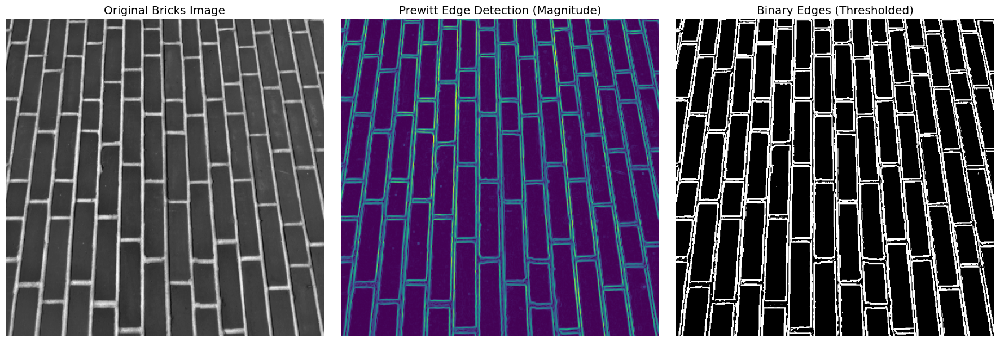

Fraction of image corresponding to edges: 0.2117 (21.17%)
Fraction of image corresponding to bricks: 0.7883 (78.83%)


In [36]:
def detect_edges_in_bricks():

    bricks = data.brick()

    # Convert to grayscale if it's a color image
    if len(bricks.shape) == 3:
        bricks_gray = color.rgb2gray(bricks)
    else:
        bricks_gray = bricks

    # Apply Prewitt edge detection filter
    edges_h = filters.prewitt_h(bricks_gray)
    edges_v = filters.prewitt_v(bricks_gray)
    edges = np.sqrt(edges_h**2 + edges_v**2)

    # Threshold the edges for binary representation
    threshold = filters.threshold_otsu(edges)
    binary_edges = edges > threshold

    # Quantify the fraction of the image corresponding to edges
    edge_fraction = np.sum(binary_edges) / binary_edges.size
    brick_fraction = 1 - edge_fraction

    # Display the results
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    axes[0].imshow(bricks, cmap='gray')
    axes[0].set_title('Original Bricks Image')
    axes[0].axis('off')

    axes[1].imshow(edges, cmap='viridis')
    axes[1].set_title('Prewitt Edge Detection (Magnitude)')
    axes[1].axis('off')

    axes[2].imshow(binary_edges, cmap='gray')
    axes[2].set_title('Binary Edges (Thresholded)')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

    print(f"Fraction of image corresponding to edges: {edge_fraction:.4f} ({edge_fraction*100:.2f}%)")
    print(f"Fraction of image corresponding to bricks: {brick_fraction:.4f} ({brick_fraction*100:.2f}%)")

    return edges, binary_edges

edges, binary_edges = detect_edges_in_bricks()

## Task 6: High-Pass and Low-Pass Filtering in Frequency Domain

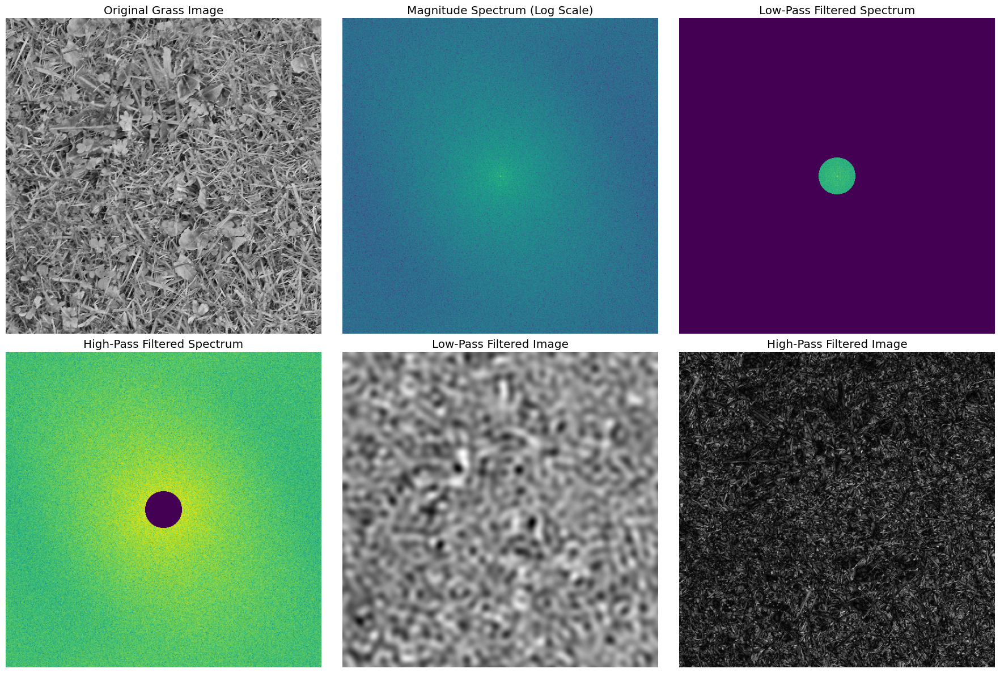

In [39]:
def frequency_domain_filtering():

    grass = data.grass()

    # Convert to grayscale if it's a color image
    if len(grass.shape) == 3:
        grass_gray = color.rgb2gray(grass)
    else:
        grass_gray = grass

    # Apply Fourier Transform
    f_transform = fftpack.fft2(grass_gray)
    # Shift the zero-frequency component to the center of the spectrum
    f_transform_shifted = fftpack.fftshift(f_transform)

    # Calculate the magnitude spectrum (log scale for better visualization)
    magnitude_spectrum = np.log1p(np.abs(f_transform_shifted))

    # Create filters in the frequency domain
    rows, cols = grass_gray.shape
    center_row, center_col = rows // 2, cols // 2

    # Create coordinate maps
    x = np.linspace(-0.5, 0.5, cols) * cols
    y = np.linspace(-0.5, 0.5, rows) * rows
    X, Y = np.meshgrid(x, y)

    # Distance from center
    R = np.sqrt(X**2 + Y**2)

    # Create low-pass filter mask (cutoff at 30 pixels from center)
    cutoff_low = 30
    low_pass_mask = R <= cutoff_low

    # Create high-pass filter mask (cutoff at 30 pixels from center)
    cutoff_high = 30
    high_pass_mask = R > cutoff_high

    # Apply filters to the Fourier transform
    f_low_pass = f_transform_shifted * low_pass_mask
    f_high_pass = f_transform_shifted * high_pass_mask

    # Inverse shift and inverse Fourier transform
    img_low_pass = np.abs(fftpack.ifft2(fftpack.ifftshift(f_low_pass)))
    img_high_pass = np.abs(fftpack.ifft2(fftpack.ifftshift(f_high_pass)))

    # Normalize the results for display
    img_low_pass = (img_low_pass - img_low_pass.min()) / (img_low_pass.max() - img_low_pass.min())
    img_high_pass = (img_high_pass - img_high_pass.min()) / (img_high_pass.max() - img_high_pass.min())

    # Visualize the results
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))

    # Original image
    axes[0, 0].imshow(grass_gray, cmap='gray')
    axes[0, 0].set_title('Original Grass Image')
    axes[0, 0].axis('off')

    # Magnitude spectrum
    axes[0, 1].imshow(magnitude_spectrum, cmap='viridis')
    axes[0, 1].set_title('Magnitude Spectrum (Log Scale)')
    axes[0, 1].axis('off')

    # Low-pass filtered magnitude spectrum
    axes[0, 2].imshow(magnitude_spectrum * low_pass_mask, cmap='viridis')
    axes[0, 2].set_title('Low-Pass Filtered Spectrum')
    axes[0, 2].axis('off')

    # High-pass filtered magnitude spectrum
    axes[1, 0].imshow(magnitude_spectrum * high_pass_mask, cmap='viridis')
    axes[1, 0].set_title('High-Pass Filtered Spectrum')
    axes[1, 0].axis('off')

    # Low-pass filtered image
    axes[1, 1].imshow(img_low_pass, cmap='gray')
    axes[1, 1].set_title('Low-Pass Filtered Image')
    axes[1, 1].axis('off')

    # High-pass filtered image
    axes[1, 2].imshow(img_high_pass, cmap='gray')
    axes[1, 2].set_title('High-Pass Filtered Image')
    axes[1, 2].axis('off')

    plt.tight_layout()
    plt.show()

frequency_domain_filtering()

 # Discussion

1. Low-pass filtering preserves the smooth, slowly varying
   regions in the image
   by keeping only the low-frequency components. This removes fine details and
   results in a blurred image where we can see the general structure of the grass.

2. High-pass filtering preserves the rapid changes (edges and fine details) in the image
   by keeping only the high-frequency components. This emphasizes the texture and
   small structures of the grass blades while removing the overall intensity variations.

3. In the Fourier transform, the center represents low frequencies (slow variations),
   while points farther from the center represent higher frequencies (rapid variations).
   The directional patterns in the spectrum correspond to dominant orientations in the
   image - the grass shows patterns radiating in various directions, reflecting its
   complex texture with blades pointing in different orientations.

## Task 7: Morphological Operations on Binary Blobs

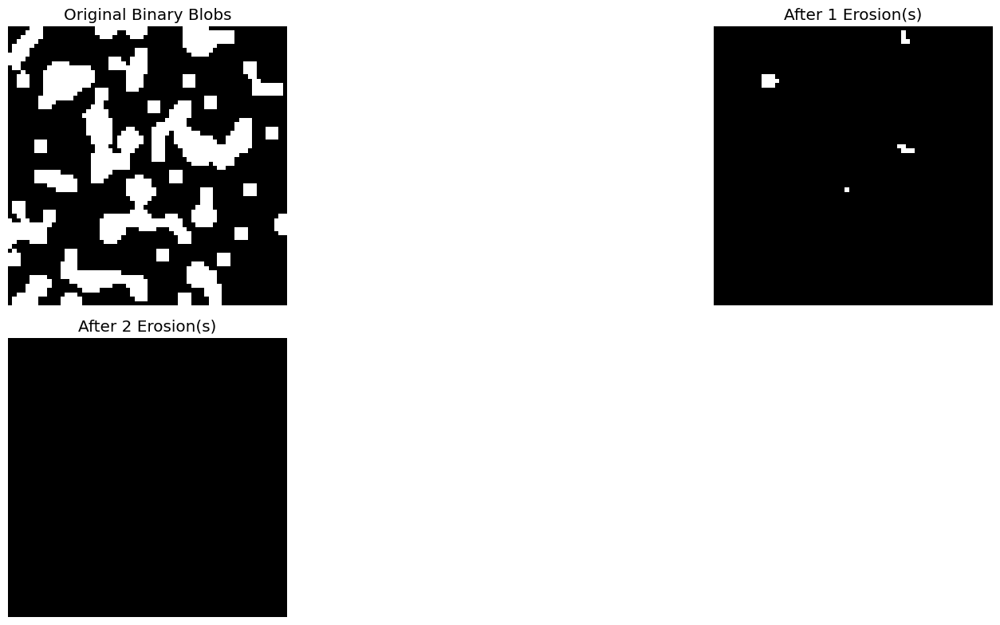

Number of consecutive erosions needed to remove all blobs: 2
Structuring element: Disk with radius 3 pixels


In [38]:
def blob_erosion_analysis():
    # Generate binary blob image (64x64 pixels, with probability 0.1 of having a blob)
    np.random.seed(42)  # For reproducibility
    blob_image = data.binary_blobs(length=64, blob_size_fraction=0.1, n_dim=2, volume_fraction=0.3)

    # Create the disk-shaped structuring element
    selem = disk(3)

    # Perform consecutive erosions until all blobs are removed
    eroded = blob_image.copy()
    erosion_steps = []
    erosion_steps.append(eroded.copy())  # Save the original

    iteration = 0
    while np.any(eroded):
        iteration += 1
        eroded = erosion(eroded, selem)
        erosion_steps.append(eroded.copy())  # Save this step

    # Set up the figure to display the erosion process
    n_steps = len(erosion_steps)
    fig, axes = plt.subplots(2, (n_steps + 1) // 2, figsize=(20, 8))
    axes = axes.ravel()

    # Plot each erosion step
    for i, img in enumerate(erosion_steps):
        axes[i].imshow(img, cmap='gray')
        if i == 0:
            axes[i].set_title(f'Original Binary Blobs')
        else:
            axes[i].set_title(f'After {i} Erosion(s)')
        axes[i].axis('off')

    # Hide unused subplots if any
    for i in range(len(erosion_steps), len(axes)):
        fig.delaxes(axes[i])

    plt.tight_layout()
    plt.show()

    # Print the result
    print(f"Number of consecutive erosions needed to remove all blobs: {iteration}")
    print(f"Structuring element: Disk with radius 3 pixels")

blob_erosion_analysis()